In [1]:
using Pkg
Pkg.activate("..")

  Activating project at `~/Desktop/MIT_research/Projects/mosquito/final_paper/MosquitoProject`


In [2]:
using MosquitoProject, DifferentialEquations, Plots

default(grid=false,legend=false, size=(400,320), dpi=300, tickfontsize=16, lw=2, labelfontsize=16, tickdir=:out, fontfamily="Arial", legendfontsize=13)

### Learned dynamical models from experimental data

Below, we list models of mosquito flight in response to no cues, visual cues alone, CO2 cues alone, and combined visual and CO2 cues.

This script generates 2D simulations of these models, but it's straightforward to adapt to 3D simulations by setting ndim=3.

In [33]:
CENTER_COORDS = [0.0 0.0 0.0]
SCALING_FACTOR = 1.0

1.0

In [34]:
function distance_to_center!(v, r; center_coords=CENTER_COORDS)
    for k in 1:length(r)
        v[k] = r[k] - center_coords[k]
    end
    dd = mynorm(v)
    v ./= dd
    return dd
end

function distance_to_center_pbc!(v, r; center_coords=CENTER_COORDS, L=0.8*SCALING_FACTOR)
    for k in 1:length(r)
        # Calculate displacement with periodic boundary conditions
        displacement = r[k] - center_coords[k]
        # Apply periodic boundary conditions
        if displacement > L
            displacement -= 2*L
        elseif displacement < -L
            displacement += 2*L
        end
        v[k] = displacement
    end
    dd = mynorm(v)
    v ./= dd
    return dd
end


distance_to_center_pbc! (generic function with 1 method)

In [35]:
function define_model(; ndim=3, f1=LaguerreFunction{Float64}(), n1=collect(0:5), p1=ones(1), c1=zeros(length(n1)), bfield1=nullfunc!,
                        f2a=LaguerreFunction{Float64}(), f2b=LaguerreFunction{Float64}(), f2ab=LegendreP{Float64}(),
                        n2a=collect(0:5), n2b=collect(0:5), n2ab=collect(0:5), c2=zeros(length(n2a)*length(n2b)*length(n2ab)),
                        p2=ones(2), bfield2=nullfunc!, D=0.0, len_scale=1.0, target=:visualco2)
    
    model=MosquitoModel(; ndim=ndim, f1=f1, f2a=f2a, f2b=f2b, f2ab=f2ab);

    model.islearned[:visual] = true
    
    if target == :visualco2
        model.funcs[:visual] = [Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 3, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 3, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 3, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 3, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 0, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 3, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 1, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 2, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 3, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 3, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 3, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 2, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 3, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 1, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 2, 3, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 0, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 1, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 1, 2, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 2, 0, :bhatorth2)]
        model.coeffs[:visual] = vcat(
                [-26.58508768656102, -10.025540504214353, -19.281931331711576, 16.977296218016942, 3.5274605792090674, -17.538921168146157, -0.8978633007550898, 0.5757674869632454, -0.34720605748622313, 27.285528208991952, -1.6629950732453829, -1.0093785167806952, -6.6835266268737215, -10.976471308197574, 87.25051545826713, 6.2020878634158185, 0.3504622511215739, 56.91679044163722, -60.54927762496129, 1.3669974738018196, 3.3570117102041386, -58.61752756159205, 1.8720678662134222],
                [-968.4160609423942, 2.938765454316324, 21.388261050998572, 3358.4406597434454, -34.40532797779392, -3931.911838118647, 4.436187969207309, 1549.2916146950502, -1.2742586401918503, 25.447437000300674, 14.92461449802172, -11.169183496972131, -3.548778046602168, -1.9539308398909119, -3.3637899732746517, -9.122537038444928]
        )
        model.params[:visual] = [2.0, len_scale]
    end
    
    if target == :visual
        model.funcs[:visual] = [Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 5, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 5, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 2, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 1, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 1, 4, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(4, 0, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(4, 1, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(4, 2, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(4, 2, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(5, 1, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(5, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(5, 2, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 1, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 2, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(4, 0, 2, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(4, 2, 2, :bhatorth2)]    
        model.coeffs[:visual] = vcat(
            [-23.049553930068313, 1.2805363220377013, 15.634000112901866, -1.6178711813269901, -1.4481040246501162, -9.628047542097333, -1.4859135403284893, 2.4996786477168658, 2.0661356872364505, 29.29125803278182, -1.6741239900815652, -2.291264005934315, -27.03018666229796, -1.1292483619710232, 1.3418076524051603, -2.2882006697246338, 23.078303770442247, 6.851874052669045, -3.2337825983991344, -5.2918543547805506, -1.8571939716476507],
            [19.393682461565486, 3.7691775260410947, -55.05475208276624, 42.11202847465953, -4.30170800452535, 10.455570562893309, -1.423554049042593, -22.845514925029146, 6.7854873442575485, 1.9311392844973874, -3.406814112103596]
        )
        model.params[:visual] = [1.0, len_scale]
    end
        
    if target == :co2
        model.funcs[:visual] = [Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 0, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 1, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 2, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 1, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 3, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 0, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 1, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 2, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 3, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(2, 3, 1, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 0, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 0, 2, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 3, 0, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 3, 3, :ahat), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(0, 3, 3, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 0, 1, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(1, 1, 0, :bhatorth2), Ψ2{LaguerreFunction{Float64}(), LaguerreFunction{Float64}(), LegendreP{Float64}()}(3, 0, 0, :bhatorth2)]
        model.coeffs[:visual] = vcat(
            [-39.563505410353486, -9.311926053131815, -1.0251077241944562, -1.4051674625111896, 11.839589512069683, -3.775510590106278, -2.305645376591694, -7.486152180561698, 120.53205753070903, 6.36056677489857, 3.2375029382577227, -5.827400073489639, -122.51054970551223, 9.463663710553451, -14.758220179371005, 0.5255283106744485, 3.3970311310452312, 10.791621285634644, 42.03259704739897, -3.337070191539953, 0.7980748466933036, 3.7103808472126425],
            [1.2229449926283504, 0.9822827479198946, 0.8021727670846446, -2.4670708959778227, 1.1549935390711488]
        )
        model.params[:visual] = [1.0, len_scale]
    end
    
    if target == :none
        model.islearned[:visual] = false
        model.islearned[:velpot] = true
        model.funcs[:velpot] = [Ψ1(f1, n, :a) for n in [0, 4, 5]];
        model.coeffs[:velpot]= [2.26539, -6.20361, 18.9581];
        model.params[:velpot] = [2.0]
    end
    
    model.bfields[:visual] = bfield2
    model.diffD = D
    
    return model

end

f_basis = LaguerreFunction{Float64}();
g_basis = LegendreP{Float64}();
model_none = define_model(; ndim=3, f2a=f_basis, f2b=f_basis, f2ab=g_basis,
        bfield2 = distance_to_center!, D=0.3, len_scale=SCALING_FACTOR, target=:none);
model_visual = define_model(; ndim=3, f2a=f_basis, f2b=f_basis, f2ab=g_basis,
        bfield2 = distance_to_center!, D=0.3, len_scale=SCALING_FACTOR, target=:visual);
model_co2 = define_model(; ndim=3, f2a=f_basis, f2b=f_basis, f2ab=g_basis,
        bfield2 = distance_to_center!, D=0.3, len_scale=SCALING_FACTOR, target=:co2);
model_visualco2 = define_model(; ndim=3, f2a=f_basis, f2b=f_basis, f2ab=g_basis,
        bfield2 = distance_to_center!, D=0.3, len_scale=SCALING_FACTOR, target=:visualco2);

### Setting up simulations

In [36]:
Rmin, Rmax = 0.05*SCALING_FACTOR, 0.8*SCALING_FACTOR
condition(u, t, integrator) = ( sqrt( (u[1]-CENTER_COORDS[1])^2 + (u[2]-CENTER_COORDS[2])^2 + (u[3]-CENTER_COORDS[3])^2 ) .< Rmin ) .| ( sqrt( (u[1]-CENTER_COORDS[1])^2 + (u[2]-CENTER_COORDS[2])^2 + (u[3]-CENTER_COORDS[3])^2 ) .> Rmax )
affect!(integrator) = terminate!(integrator)
cb = DiscreteCallback(condition, affect!);

dts = 0.01
solver = SOSRA();

In [37]:
function sample_init(; r₀ = 0.5, v₀ = 0.5, σᵥ = 0.2 )
    # Sample radius with proper distribution for uniform sampling in sphere
    r = r₀ * cbrt(rand())
    # Sample angles for spherical coordinates
    θ = acos(2*rand() - 1)  # Uniform on [0, π]
    ϕ = rand()*2π          # Uniform on [0, 2π]
    
    # Sample velocity magnitude and direction
    v = v₀ + σᵥ * randn()
    α = acos(2*rand() - 1)  # Velocity polar angle
    β = rand()*2π          # Velocity azimuthal angle
    
    # Convert to Cartesian coordinates
    x = r * sin(θ) * cos(ϕ)
    y = r * sin(θ) * sin(ϕ)
    z = r * cos(θ)
    
    vx = v * sin(α) * cos(β)
    vy = v * sin(α) * sin(β)
    vz = v * cos(α)
    
    return [x, y, z, vx, vy, vz]
end

sample_init (generic function with 1 method)

In [38]:
function plot_circle(center_coords, radius)
    p_circle = plot(; frame_style=:box, aspect_ratio=1, 
        xlim=(-0.5,+0.5), ylim=(-0.5,+0.5), xtick=[], ytick=[] )
    theta = collect(range(0,2π,101))
    plot!(p_circle, radius .* cos.(theta) .+ center_coords[1], radius .* sin.(theta) .+ center_coords[2], lc=:black, lw=2)
    p_circle
end

plot_circle (generic function with 1 method)

### Simulate models and make plots

In [ ]:
function simulate_trajectories(model; N=100, dts=0.01, solver=solver, cb=cb, Tmax=5.0, 
                                        CENTER_COORDS=CENTER_COORDS, Rmax=Rmax, title="Default cues")
    tspans = [(0, Tmax) for _ in 1:N]; 
    ics = [sample_init() for _ in 1:N];
    ts, xys, vels  = sde_sim(model, ics, tspans, solver; dts=dts, callback=cb);
    speeds = [sqrt.(sum(abs2, vels[i], dims=2)) for i in 1:N];
    
    return ts, xys, vels, speeds
end


function simulate_and_plot_trajectories(model; N=100, dts=0.01, solver=solver, cb=cb, Tmax=2.0, 
                                        CENTER_COORDS=CENTER_COORDS, Rmax=Rmax, title="Default cues")
    tspans = [(0, Tmax) for _ in 1:N]; 
    ics = [sample_init() for _ in 1:N];
    ts, xys, vels  = sde_sim(model, ics, tspans, solver; dts=dts, callback=cb);
    speeds = [sqrt.(sum(abs2, vels[i], dims=2)) for i in 1:N];
    
    p = plot_circle(CENTER_COORDS, Rmin)
    plot!(p, title=title)
    for i in 1:N
        plot!(p, xys[i][:,1], xys[i][:,2], lw=1.0, alpha=0.3, line_z = speeds[i], cmap = :ice, clim=(0.0, 1.0))
    end
    return p
end

simulate_and_plot_trajectories (generic function with 1 method)

In [39]:
ts_none, xys_none, vels_none, speeds_none = simulate_trajectories(model_none, title="None")
ts_visual, xys_visual, vels_visual, speeds_visual = simulate_trajectories(model_visual, title="Visual")
ts_co2, xys_co2, vels_co2, speeds_co2 = simulate_trajectories(model_co2, title="CO2")
ts_visualco2, xys_visualco2, vels_visualco2, speeds_visualco2 = simulate_trajectories(model_visualco2, title="Visual+CO2")

([[0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09  …  1.91, 1.92, 1.93, 1.94, 1.95, 1.96, 1.97, 1.98, 1.99, 2.0], [0.0, 0.01, 0.

In [40]:
size(ts_none[1]), size(xys_none[1]), size(vels_none[1]), size(speeds_none[1])

((69,), (69, 3), (69, 3), (69, 1))

In [45]:
using CSV, DataFrames

function save_simulation_to_csv(ts, xys, vels, speeds, filename)
    # Create a DataFrame to store all trajectories
    df = DataFrame()
    
    for i in 1:length(ts)
        # For each trajectory
        n_points = length(ts[i])
        
        # Create a sub-dataframe for this trajectory
        sub_df = DataFrame(
            track_id = fill(i, n_points),
            time = ts[i],
            x = xys[i][:,1],
            y = xys[i][:,2],
            z = xys[i][:,3], 
            vx = vels[i][:,1],
            vy = vels[i][:,2],
            vz = vels[i][:,3],  
            speed = speeds[i][:,1]
        )
        
        # Append to the main dataframe
        df = vcat(df, sub_df)
    end
    
    # Save to CSV
    CSV.write(filename, df)
    println("Saved simulation data to $filename")
end

# Save each simulation to a CSV file
save_simulation_to_csv(ts_none, xys_none, vels_none, speeds_none, "simulation_none.csv")
save_simulation_to_csv(ts_visual, xys_visual, vels_visual, speeds_visual, "simulation_visual.csv")
save_simulation_to_csv(ts_co2, xys_co2, vels_co2, speeds_co2, "simulation_co2.csv")
save_simulation_to_csv(ts_visualco2, xys_visualco2, vels_visualco2, speeds_visualco2, "simulation_visualco2.csv")


Saved simulation data to simulation_none.csv
Saved simulation data to simulation_visual.csv
Saved simulation data to simulation_co2.csv
Saved simulation data to simulation_visualco2.csv


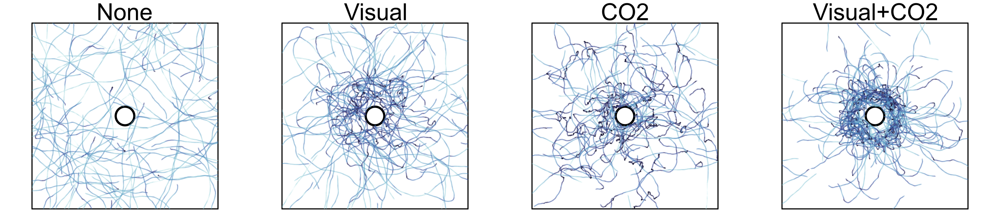

In [15]:
p_none = simulate_and_plot_trajectories(model_none, title="None")
p_visual = simulate_and_plot_trajectories(model_visual, title="Visual")
p_co2 = simulate_and_plot_trajectories(model_co2, title="CO2")
p_visualco2 = simulate_and_plot_trajectories(model_visualco2, title="Visual+CO2")

plot(p_none, p_visual, p_co2, p_visualco2, layout=(1,4), size=(900,200))